In [74]:
import xarray as xr
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import xrsignal
from scipy import signal
from dask.distributed import Client
import hvplot.xarray

%matplotlib inline
%config InlineBackend.figure_format = 'svg'

In [2]:
client = Client()
client

Connection method: Cluster object,Cluster type: distributed.LocalCluster
Dashboard: http://127.0.0.1:8787/status,
Dashboard: http://127.0.0.1:8787/status,Workers: 8
Total threads: 32,Total memory: 62.79 GiB
Status: running,Using processes: True
Comm: tcp://127.0.0.1:45089,Workers: 8
Dashboard: http://127.0.0.1:8787/status,Total threads: 32
Started: Just now,Total memory: 62.79 GiB
Comm: tcp://127.0.0.1:33963,Total threads: 4
Dashboard: http://127.0.0.1:38017/status,Memory: 7.85 GiB
Nanny: tcp://127.0.0.1:34901,


# 1-5 Hz
generate a quick figure

In [3]:
time_coord = pd.date_range(pd.Timestamp('2015-01-01'), pd.Timestamp('2022-12-31 23:59:59.999'), freq='1H')
fn = '/datadrive/NCCFs/1hr_20150101_20230101_ec_cc_fcs_1_90.nc'
NCCFs = xr.open_dataarray(fn)

NCCFs = NCCFs.chunk({'time':100, 'delay':11999}).assign_coords({'time':time_coord})

In [4]:
b,a = signal.butter(4, [0.01, 0.05], btype='bandpass')

NCCFs_1_5 = xrsignal.filtfilt(NCCFs, dim='delay', b=b, a=a)

In [7]:
NCCFs_10hr = NCCFs_1_5.rolling(time=10, min_periods=1).mean().compute()

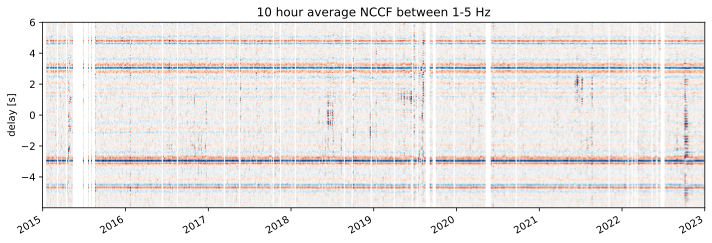

In [15]:
fig = plt.figure(figsize=(10,3.5))
NCCFs_10hr[::25,:].loc[:,-6:6].plot(x='time', cmap='RdBu', rasterized=True, vmax=0.001, vmin=-0.001, add_colorbar=False)
plt.title('10 hour average NCCF between 1-5 Hz')
plt.xlabel('')
plt.ylabel('delay [s]')
plt.tight_layout()

fig.savefig('figures/10hr_1-5_NCCF.svg', dpi=300)

# Changing Peak Shape

In [3]:
fn = '/datadrive/NCCFs/averaged/201.nc'
NCCFs = xr.open_dataarray(fn)

In [28]:
NCCFs_interp = NCCFs[::201].where(~np.isnan(NCCFs[::201]), drop=True).interp({'delay':np.arange(-10,10,0.0005)}, method='cubic')
NCCFs_interp_c = xrsignal.hilbert_mag(NCCFs_interp, dim='delay')

In [31]:
before_q = NCCFs_interp_c.loc[:pd.Timestamp('2019-01-01')].quantile([0.25, 0.5, 0.75], dim='time')
after_q = NCCFs_interp_c.loc[pd.Timestamp('2019-01-01'):].quantile([0.25, 0.5, 0.75], dim='time')

In [78]:
fig = plt.figure(figsize=(10,3))

plt.subplot(1,2,1)
before_q[1,:].plot(label='before 2019')
plt.fill_between(before_q.delay, before_q[0,:], before_q[2,:], alpha=0.6)

after_q[1,:].plot(label='after 2019')
plt.fill_between(after_q.delay, after_q[0,:], after_q[2,:], alpha=0.6)
plt.xlim([-3.2, -2.8])
plt.legend()
plt.title('lag surface reflection')

plt.subplot(1,2,2)
before_q[1,:].plot(label='before 2019')
plt.fill_between(before_q.delay, before_q[0,:], before_q[2,:], alpha=0.6)

after_q[1,:].plot(label='after 2019')
plt.fill_between(after_q.delay, after_q[0,:], after_q[2,:], alpha=0.6)
plt.xlim([2.8, 3.2])
plt.legend()
plt.title('lead surface reflection')

fig.savefig('figures/before_after_2019_s1b0.svg')

In [79]:
fig = plt.figure(figsize=(10,3))

plt.subplot(1,2,1)
before_q[1,:].plot(label='before 2019')
plt.fill_between(before_q.delay, before_q[0,:], before_q[2,:], alpha=0.6)

after_q[1,:].plot(label='after 2019')
plt.fill_between(after_q.delay, after_q[0,:], after_q[2,:], alpha=0.6)
plt.xlim([-3.05, -2.95])
plt.legend()
plt.title('lag surface reflection')

plt.subplot(1,2,2)
before_q[1,:].plot(label='before 2019')
plt.fill_between(before_q.delay, before_q[0,:], before_q[2,:], alpha=0.6)

after_q[1,:].plot(label='after 2019')
plt.fill_between(after_q.delay, after_q[0,:], after_q[2,:], alpha=0.6)
plt.xlim([2.98, 3.0])
plt.legend()
plt.title('lead surface reflection')
fig.savefig('figures/before_after_2019_s1b0_zoomed.svg')

In [59]:
fn = '/datadrive/simulation/caldera_inversion_timeseries_HYCOM2.nc'
tdgf_sim = xr.open_dataarray(fn)

In [60]:
tdgf_sim_interp = tdgf_sim.where(~np.isnan(tdgf_sim), drop=True).interp({'time':np.arange(0,10,0.0005)}, method='cubic')
tdgf_sim_interp_c = xrsignal.hilbert_mag(tdgf_sim_interp, dim='time')
before_q_sim = tdgf_sim_interp_c.loc[:pd.Timestamp('2019-01-01')].quantile([0.25, 0.5, 0.75], dim='date')
after_q_sim = tdgf_sim_interp_c.loc[pd.Timestamp('2019-01-01'):].quantile([0.25, 0.5, 0.75], dim='date')

In [65]:
fig = plt.figure(figsize=(5,3))

before_q_sim[1,:].plot(label='before 2019')
plt.fill_between(before_q_sim.time, before_q_sim[0,:], before_q_sim[2,:], alpha=0.6)

after_q_sim[1,:].plot(label='after 2019')
plt.fill_between(after_q_sim.time, after_q_sim[0,:], after_q_sim[2,:], alpha=0.6)
plt.xlim([2.95, 3.05])
plt.legend()
plt.title('lead surface reflection')

Text(0.5, 1.0, 'lead surface reflection')

(2.95, 3.05)

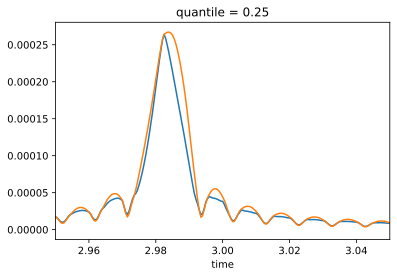

In [71]:
before_q_sim[0,:].plot()

after_q_sim[0,:].plot()
plt.xlim([2.95, 3.05])

In [76]:
tdgf_sim_interp_c.hvplot.image(x='date', rasterize=True)

OMP: Info #276: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.


:DynamicMap   []
   :Image   [date,time]   (value)